In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from utils import plot_features_boxplot,create_metrics_df, plot_partial_dependence, plot_pdp_interactions

#### Loading Dataset

*Context*

This dataset is originally from the National Institute of Diabetes and Digestive and Kidney Diseases. The objective of the dataset is to diagnostically predict whether or not a patient has diabetes, based on certain diagnostic measurements included in the dataset. Several constraints were placed on the selection of these instances from a larger database. In particular, all patients here are females at least 21 years old of Pima Indian heritage.

*Content*

The datasets consists of several medical predictor variables and one target variable, Outcome. Predictor variables includes the number of pregnancies the patient has had, their BMI, insulin level, age, and so on.

In [2]:
df = pd.read_csv('Data\diabetes.csv')
print(df.shape)
print(df.columns)
df.head()

(768, 9)
Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


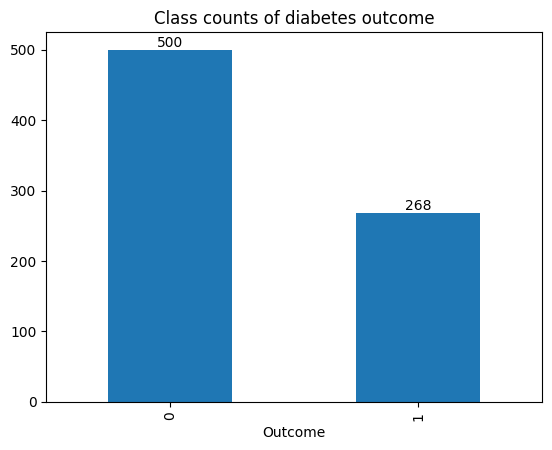

In [3]:

df['Outcome'].value_counts().plot(kind='bar')
# Add explict count for each class in the plot
for i, count in enumerate(df['Outcome'].value_counts()):
    plt.text(i, count, str(count), ha='center', va='bottom')

plt.title('Class counts of diabetes outcome')
plt.show()

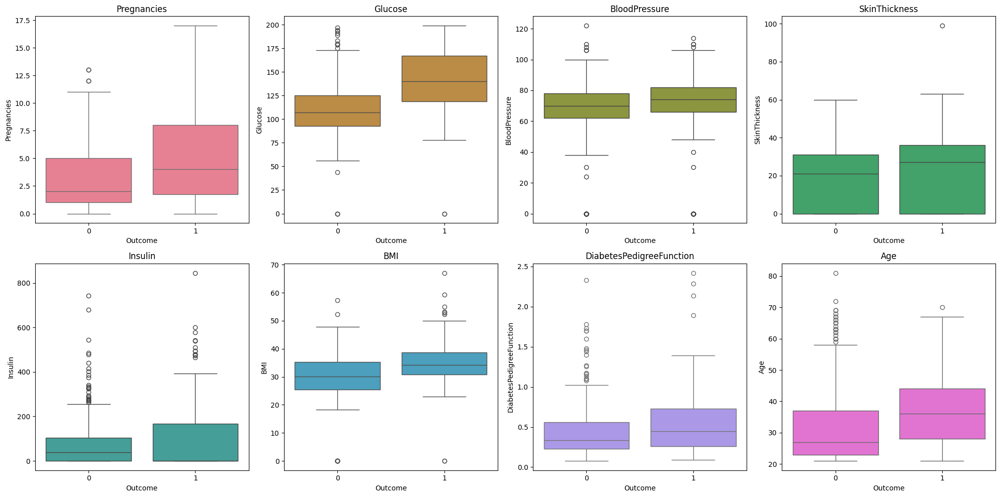

In [5]:
plot_features_boxplot(df, 4)

https://pubmed.ncbi.nlm.nih.gov/14514582/

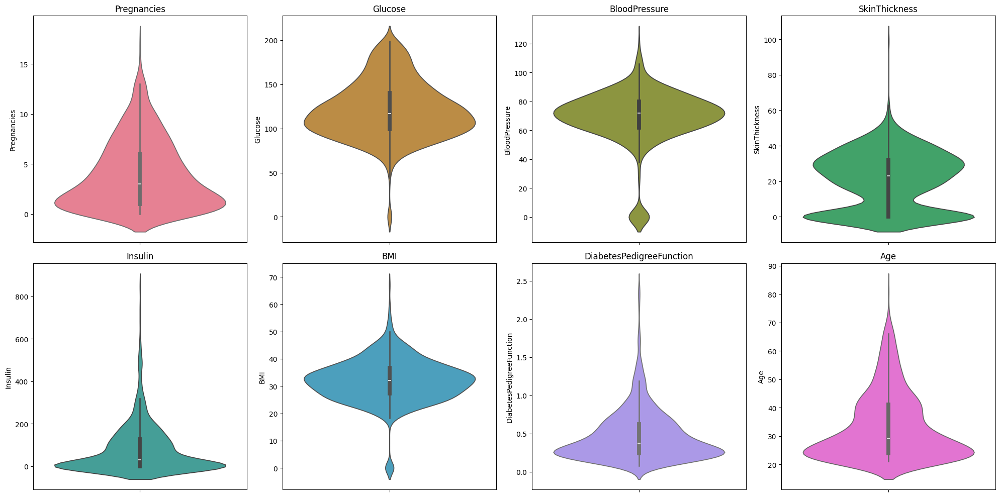

In [6]:
plot_features_boxplot(df, 4, feature_by_outcome=False,violinplot=True)

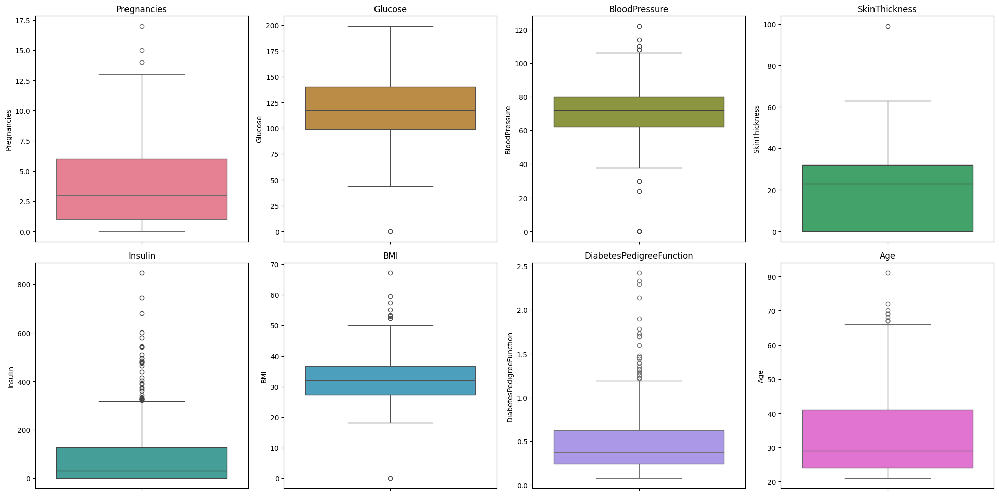

In [7]:
plot_features_boxplot(df, 4, feature_by_outcome=False)

Como pode ser visto acima o dataset em questão possui exclusivamente features numéricas, além disso o mesmo está desbalanceado com praticamente proporção 2:1.

Para futura avaliação dos modelos criarei uma versão do dataset com balanceamento utilizando o resample da biblioteca scikit-learn.

Será feita a separação de treino e teste com 75% para treino e 25% para teste.

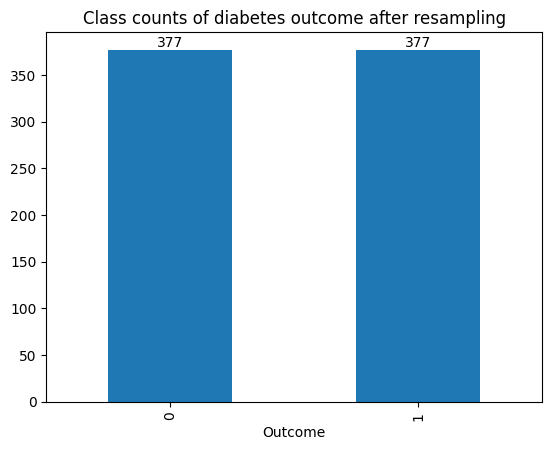

In [8]:
import pandas as pd
from sklearn.utils import resample
from sklearn.model_selection import train_test_split

X = df.drop(columns=['Outcome'])
Y = df['Outcome']
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=42)

df_train = pd.concat([X_train, Y_train], axis=1)
df_majority = df_train[df_train['Outcome'] == 0]
df_minority = df_train[df_train['Outcome'] == 1]

df_minority_upsampled = resample(df_minority, replace=True, n_samples=len(df_majority), random_state=42)

df_upsampled = pd.concat([df_majority, df_minority_upsampled])

X_train_upsampled = df_upsampled.drop(columns=['Outcome'])
Y_train_upsampled = df_upsampled['Outcome']

ax = df_upsampled['Outcome'].value_counts().plot(kind='bar')
for i, count in enumerate(df_upsampled['Outcome'].value_counts()):
    plt.text(i, count, str(count), ha='center', va='bottom')
plt.title('Class counts of diabetes outcome after resampling')
plt.show()

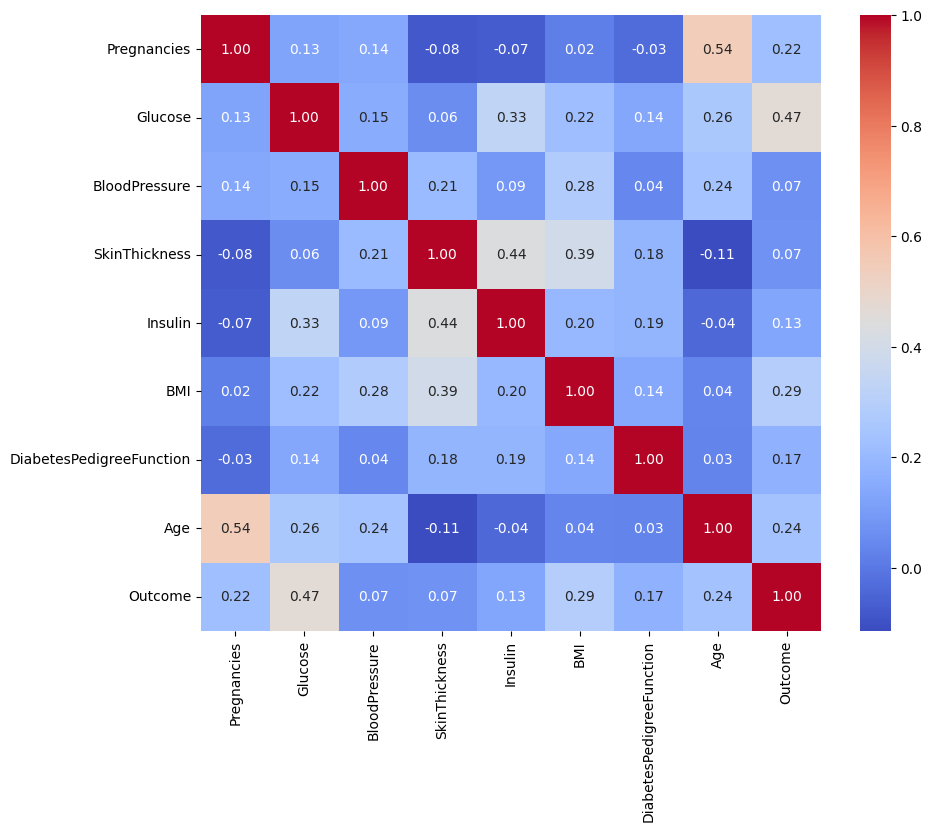

In [9]:
# Calculate the correlation matrix
correlation_matrix = df.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()


Como pode ser visto acima existe uma correlação consideravelmente alta entre glicose e o diagnóstico e entre a idade e número de gravidez (naturalmente, visto que mulheres mais velhas terão muito mais chance de terem mais filhos do que mulheres mais jovens).

#### Training Model

In [10]:
from sklearn.inspection import PartialDependenceDisplay

from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier().fit(X_train, Y_train)

upsampled_rf = RandomForestClassifier().fit(X_train_upsampled, Y_train_upsampled)

In [11]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=5)

neigh.fit(X_train, Y_train)

upsampled_neigh = KNeighborsClassifier(n_neighbors=5)

upsampled_neigh.fit(X_train_upsampled, Y_train_upsampled)

KNeighborsClassifier()

In [12]:
from sklearn.svm import SVC

svm = SVC(random_state=42)
svm.fit(X_train, Y_train)

upsampled_svm = SVC(random_state=42,probability=True)
upsampled_svm.fit(X_train_upsampled, Y_train_upsampled)

SVC(probability=True, random_state=42)

In [13]:
from sklearn.linear_model import LogisticRegression

log_reg = LogisticRegression(random_state=42,max_iter=1000)
log_reg.fit(X_train, Y_train)

upsampled_log_reg = LogisticRegression(random_state=42,max_iter=1000)
upsampled_log_reg.fit(X_train_upsampled, Y_train_upsampled)

LogisticRegression(max_iter=1000, random_state=42)

In [14]:
classifiers = [
    ('Random Forest', rf),
    ('Random Forest (Upsampled)', upsampled_rf),
    ('K-Nearest Neighbors', neigh),
    ('K-Nearest Neighbors (Upsampled)', upsampled_neigh),
    ('SVM', svm),
    ('SVM (Upsampled)', upsampled_svm),
    ('Logistic Regression', log_reg),
    ('Logistic Regression (Upsampled)', upsampled_log_reg)
]

metrics_df = create_metrics_df(classifiers, X_test, Y_test)

# style the DataFrame with various color gradients for each row
cm = sns.light_palette("green", as_cmap=True)
s = metrics_df.T.style.background_gradient(cmap=cm)
s

,accuracy,precision,recall,f1
Random Forest,0.750000,0.650000,0.650000,0.650000
Random Forest (Upsampled),0.740000,0.650000,0.640000,0.640000
K-Nearest Neighbors,0.660000,0.520000,0.550000,0.540000
K-Nearest Neighbors (Upsampled),0.660000,0.520000,0.720000,0.610000
SVM,0.730000,0.670000,0.490000,0.570000
SVM (Upsampled),0.690000,0.550000,0.700000,0.620000
Logistic Regression,0.720000,0.610000,0.640000,0.620000
Logistic Regression (Upsampled),0.700000,0.560000,0.720000,0.630000


É interessante observar que o upsample da base de treino melhorou o resultado dos modelos KNN, SVM e Logistic Regression. Apesar da redução da métrica de precisão (significa que o modelo está marcando mais falsos positivos), o balanceamento possibilitou o modelo conseguir dar uma atenção mais efetiva a classe minoritária (positivos), isso pode ser observado com a melhora da métrica de recall. Além disso, o fato da métrica f1 ter melhorado indica que o ganho em recall foi mais significativo do que a perda em precisão em relação ao balanceamento dos modelos.

### **LIME - LOCAL EXPLANATIONS**





**--- CREATING THE EXPLAINER**

In [15]:
from lime import lime_tabular

from lime.lime_tabular import LimeTabularExplainer

def create_explainer(train_data, feature_names, class_names=["no", "yes"], discretize_continuous=False):
    explainer = LimeTabularExplainer(train_data.values,
                                     feature_names=feature_names,
                                     class_names=class_names,
                                     discretize_continuous=discretize_continuous)
    return explainer

def explain_instance_with_lime(model, explainer, instance_values, num_features=8,num_samples=1000):
    # Flatten the array to 1D ensuring it matches the training data's feature order
    explanation = explainer.explain_instance(instance_values.flatten(), 
                                             model.predict_proba,
                                             num_features=num_features,
                                             top_labels=1,
                                             num_samples=num_samples)
    return explanation

In [21]:
import warnings
from sklearn.exceptions import DataConversionWarning

# Suppress specific sklearn warning
warnings.filterwarnings(action='ignore', category=UserWarning, message="X does not have valid feature names")


In [164]:
X_test

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
668,6,98,58,33,190,34.0,0.430,43
324,2,112,75,32,0,35.7,0.148,21
624,2,108,64,0,0,30.8,0.158,21
690,8,107,80,0,0,24.6,0.856,34
473,7,136,90,0,0,29.9,0.210,50
...,...,...,...,...,...,...,...,...
554,1,84,64,23,115,36.9,0.471,28
319,6,194,78,0,0,23.5,0.129,59
594,6,123,72,45,230,33.6,0.733,34
6,3,78,50,32,88,31.0,0.248,26


**--- RUNNING LIME ON AN INSTANCE**

In [16]:
explainer = create_explainer(X_train, X_train.columns)

In [166]:
Y_test.iloc[i]

0

In [23]:
def explain_random_group(classifier, X_test, Y_test, explainer,number_of_instances=10,cls_name=None,num_samples=1000):
    positive_indices = Y_test[Y_test == 1].index
    random_positive_indices = np.random.choice(positive_indices, number_of_instances)
    negative_indices = Y_test[Y_test == 0].index
    random_negative_indices = np.random.choice(negative_indices, number_of_instances)
    if cls_name:
        print(f'Explaining instances for {cls_name}')
    for i in random_positive_indices:
        print(f'Instance {i}')
        print(f'True class: {Y_test.loc[i]}')
        print(f'Model output: {classifier.predict(X_test.loc[i,:].values.reshape(1, -1))[0]}')
        exp = explain_instance_with_lime(classifier, explainer, X_test.loc[i,:].values,num_samples=num_samples)
        exp.show_in_notebook(show_table=True, show_all=False)
    for i in random_negative_indices:
        print(f'Instance {i}')
        print(f'True class: {Y_test.loc[i]}')
        print(f'Model output: {classifier.predict(X_test.loc[i,:].values.reshape(1, -1))[0]}')
        exp = explain_instance_with_lime(classifier, explainer, X_test.loc[i,:].values,num_samples=num_samples)
        exp.show_in_notebook(show_table=True, show_all=False)

def order_feature_importance(classifier, X_test, explainer,num_samples=1000):
    feature_importance_order = {}
    for i in range(X_test.shape[0]):
        exp = explain_instance_with_lime(classifier, explainer, X_test.iloc[i, :].values,num_samples=num_samples)
        available_labels = exp.available_labels()
        if 1 in available_labels:
            label_to_use = 1
        else:
           
            if available_labels:
                label_to_use = available_labels[0]
            else:
                print('No labels avaliable, skipping')
                continue 
        
        for feature, importance in exp.as_list(label=label_to_use):
            if feature not in feature_importance_order:
                feature_importance_order[feature] = [importance]
            else:
                feature_importance_order[feature].append(importance)

    # Calculate the average importance for each feature
    avg_feature_importance = {feature: np.mean(importances) for feature, importances in feature_importance_order.items()}
    avg_feature_importance = dict(sorted(avg_feature_importance.items(), key=lambda x: x[1], reverse=True))
    return avg_feature_importance

def order_feature_importance_by_position(classifier, X_test, explainer,num_samples=1000):
    feature_positions = {}

    # Loop through each test instance
    for i in range(X_test.shape[0]):
        exp = explain_instance_with_lime(classifier, explainer, X_test.iloc[i, :].values,num_samples=num_samples)
        available_labels = exp.available_labels()
        
        label_to_use = available_labels[0] if available_labels else None
        if label_to_use is None:
            print('No labels avaliable')
            continue

        # Get the list of features and their importance
        feature_list = exp.as_list(label=label_to_use)
        
        # Record the positions of each feature in this instance's explanation
        for position, (feature, _) in enumerate(feature_list, start=1):
            if feature not in feature_positions:
                feature_positions[feature] = [position]
            else:
                feature_positions[feature].append(position)

    # Calculate the average position for each feature
    avg_feature_positions = {feature: np.mean(positions) for feature, positions in feature_positions.items()}

    # Sort features by their average position
    sorted_avg_feature_positions = dict(sorted(avg_feature_positions.items(), key=lambda x: x[1]))

    return sorted_avg_feature_positions

#### Results for Random Forest

In [168]:
order_feature_importance(rf,X_test,explainer)

{'BloodPressure': 0.0006496742650521039,
 'Insulin': -0.0016648891413578986,
 'SkinThickness': -0.0018690751143432688,
 'Pregnancies': -0.006053942717851475,
 'DiabetesPedigreeFunction': -0.006797882575328069,
 'Age': -0.014002518039479791,
 'BMI': -0.017666523492688657,
 'Glucose': -0.024121141459040655}

In [169]:
order_feature_importance_by_position(rf,X_test,explainer)

{'Glucose': 1.0,
 'BMI': 2.0625,
 'Age': 2.9375,
 'DiabetesPedigreeFunction': 4.020833333333333,
 'Pregnancies': 5.015625,
 'SkinThickness': 6.125,
 'Insulin': 7.291666666666667,
 'BloodPressure': 7.546875}

In [25]:
explain_random_group(rf, X_test, Y_test, explainer, number_of_instances=3,num_samples=10)

Instance 193
True class: 1
Model output: 1


Instance 39
True class: 1
Model output: 1


Instance 604
True class: 1
Model output: 1


Instance 470
True class: 0
Model output: 1


Instance 290
True class: 0
Model output: 0


Instance 745
True class: 0
Model output: 0


#### Results for LogiticRegression

In [171]:
order_feature_importance(upsampled_log_reg,X_test,explainer)

{'BloodPressure': 0.002780257252489759,
 'Insulin': 0.00124536234771102,
 'SkinThickness': 0.0008147509915244895,
 'DiabetesPedigreeFunction': -0.0018313390578580415,
 'Pregnancies': -0.002211452494317082,
 'Age': -0.004362301674168825,
 'BMI': -0.00921521421451379,
 'Glucose': -0.011182188158227939}

In [172]:
order_feature_importance_by_position(upsampled_log_reg,X_test,explainer)

{'Glucose': 1.0,
 'BMI': 2.0,
 'Age': 3.0,
 'BloodPressure': 4.0,
 'Pregnancies': 5.0,
 'DiabetesPedigreeFunction': 6.0,
 'Insulin': 7.0,
 'SkinThickness': 8.0}

In [173]:
explain_random_group(upsampled_log_reg, X_test, Y_test, explainer, number_of_instances=4)

Instance 72
True class: 1
Model output: 1


Instance 6
True class: 1
Model output: 0


Instance 448
True class: 1
Model output: 0


Instance 375
True class: 1
Model output: 1


Instance 548
True class: 0
Model output: 1


Instance 81
True class: 0
Model output: 0


Instance 483
True class: 0
Model output: 0


Instance 718
True class: 0
Model output: 0


#### Results for KNN

In [174]:
order_feature_importance(upsampled_neigh,X_test,explainer)

{'Glucose': 0.003480666513090908,
 'SkinThickness': 0.0016360109388291544,
 'BMI': 0.0004903513980954681,
 'DiabetesPedigreeFunction': 0.00019849894197422092,
 'Pregnancies': -0.00033430102714098955,
 'Age': -0.0010133214855574755,
 'BloodPressure': -0.001081066495900055,
 'Insulin': -0.00127365082075928}

In [175]:
order_feature_importance_by_position(upsampled_neigh,X_test,explainer)

{'Glucose': 1.0,
 'Age': 2.0260416666666665,
 'BMI': 3.3489583333333335,
 'Insulin': 3.9322916666666665,
 'BloodPressure': 5.583333333333333,
 'SkinThickness': 5.640625,
 'Pregnancies': 7.005208333333333,
 'DiabetesPedigreeFunction': 7.463541666666667}

In [176]:
explain_random_group(upsampled_neigh, X_test, Y_test, explainer, number_of_instances=4)

Instance 292
True class: 1
Model output: 1


Instance 31
True class: 1
Model output: 1


Instance 84
True class: 1
Model output: 1


Instance 227
True class: 1
Model output: 1


Instance 462
True class: 0
Model output: 0


Instance 260
True class: 0
Model output: 1


Instance 44
True class: 0
Model output: 1


Instance 483
True class: 0
Model output: 0


#### Results for SVM

In [179]:
order_feature_importance(upsampled_svm,X_test,explainer)

{'Insulin': 0.016674113113056808,
 'BloodPressure': 0.0012644950649122286,
 'DiabetesPedigreeFunction': -0.00010779616104168237,
 'SkinThickness': -0.0003829354327541062,
 'Pregnancies': -0.0006428280164654738,
 'Age': -0.003572941536193594,
 'BMI': -0.004003633718271167,
 'Glucose': -0.010592080113737488}

In [180]:
order_feature_importance_by_position(upsampled_svm,X_test,explainer)

{'Glucose': 1.0,
 'Insulin': 2.5572916666666665,
 'BMI': 2.75,
 'Age': 3.734375,
 'BloodPressure': 5.432291666666667,
 'SkinThickness': 5.53125,
 'Pregnancies': 7.088541666666667,
 'DiabetesPedigreeFunction': 7.90625}

In [181]:
explain_random_group(upsampled_svm, X_test, Y_test, explainer, number_of_instances=4)

Instance 356
True class: 1
Model output: 1


Instance 72
True class: 1
Model output: 1


Instance 84
True class: 1
Model output: 1


Instance 648
True class: 1
Model output: 1


Instance 629
True class: 0
Model output: 0


Instance 544
True class: 0
Model output: 0


Instance 44
True class: 0
Model output: 1


Instance 483
True class: 0
Model output: 0


: 